In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import pickle

from sklearn import preprocessing, decomposition, manifold
from pandas_profiling import ProfileReport
from scipy.cluster import hierarchy
from mpl_toolkits.mplot3d import Axes3D

# Récupération des données

In [2]:
# récupération des objets pickle

dict_quarter = pickle.load(open("pickle_dict_quarter.pkl", "rb"))
dict_month = pickle.load(open("pickle_dict_month.pkl", "rb"))
grouped_categories = pickle.load(open("pickle_grouped_categories.pkl", "rb"))
list_payment_types = pickle.load(open("pickle_list_payment_types.pkl", "rb"))

# Analyse exploratoire des données du dernier trimestre

In [3]:
# premières informations

data = dict_quarter["2018Q2"]

print(data.shape)

data.head()

(19391, 22)


,city_rank,orders_count,review_score_mean,review_user,nb_items,total_spent,mean_spent,body,electronic_computers,cars,...,food,family_pets,clothes_fashion,art_music_books,professionnal,boleto,credit_card,debit_card,voucher,not_defined
customer_unique_id,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.0,1,5.0,1.0,1,141.90,141.90,0,0,0,...,0,0,0,0,0,0,1,0,0,0
0000b849f77a49e4a4ce2b2a4ca5be3f,3.0,1,4.0,0.0,1,27.19,27.19,1,0,0,...,0,0,0,0,0,0,1,0,0,0
0004bd2a26a76fe21f786e4fbd80607f,5.0,1,4.0,0.0,1,166.98,166.98,0,0,0,...,0,0,0,0,0,0,1,0,0,0
00050ab1314c0e55a6ca13cf7181fecf,4.0,1,4.0,0.0,1,35.38,35.38,0,1,0,...,0,0,0,0,0,1,0,0,0,0
000949456b182f53c18b68d6babc79c1,3.0,1,4.0,0.0,1,82.05,82.05,0,1,0,...,0,0,0,0,0,1,0,0,0,0


In [4]:
# statistiques sur les données

print(data["orders_count"].sum())

data.describe()

19646


,city_rank,orders_count,review_score_mean,review_user,nb_items,total_spent,mean_spent,body,electronic_computers,cars,...,food,family_pets,clothes_fashion,art_music_books,professionnal,boleto,credit_card,debit_card,voucher,not_defined
count,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,...,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.0
mean,2.466660,1.013150,4.237163,0.453509,1.167913,168.822224,150.813489,0.148626,0.153783,0.049043,...,0.017121,0.099428,0.026146,0.034088,0.053324,0.185447,0.799288,0.016657,0.051622,0.0
std,1.981785,0.118362,1.222012,0.510834,0.588057,231.156097,207.109665,0.412771,0.433120,0.236045,...,0.181154,0.342329,0.181641,0.194094,0.286976,0.393286,0.430816,0.128790,0.379688,0.0
min,0.000000,1.000000,1.000000,0.000000,1.000000,10.890000,10.890000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
25%,0.000000,1.000000,4.000000,0.000000,1.000000,64.030000,58.340000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.0
50%,2.000000,1.000000,5.000000,0.000000,1.000000,110.670000,99.900000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.0
75%,5.000000,1.000000,5.000000,1.000000,1.000000,183.590000,164.795000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.0
max,5.000000,3.000000,5.000000,4.000000,13.000000,4681.780000,4681.780000,6.000000,13.000000,5.000000,...,10.000000,12.000000,6.000000,4.000000,7.000000,3.000000,3.000000,2.000000,14.000000,0.0


In [5]:
# début du tableau à intégrer à la présentation
data.describe().iloc[:,[0,1,2,3,4,5,6]]

,city_rank,orders_count,review_score_mean,review_user,nb_items,total_spent,mean_spent
count,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000
mean,2.466660,1.013150,4.237163,0.453509,1.167913,168.822224,150.813489
std,1.981785,0.118362,1.222012,0.510834,0.588057,231.156097,207.109665
min,0.000000,1.000000,1.000000,0.000000,1.000000,10.890000,10.890000
25%,0.000000,1.000000,4.000000,0.000000,1.000000,64.030000,58.340000
50%,2.000000,1.000000,5.000000,0.000000,1.000000,110.670000,99.900000
75%,5.000000,1.000000,5.000000,1.000000,1.000000,183.590000,164.795000
max,5.000000,3.000000,5.000000,4.000000,13.000000,4681.780000,4681.780000


In [6]:
# stats sur les catégories

total = pd.Series(data.iloc[:,[7,8,9,10,11,12,13,14,15,16]].sum(), name="total")
data.describe().iloc[:,[7,8,9,10,11,12,13,14,15,16]].append(total)


,body,electronic_computers,cars,house,leisure_gifts,food,family_pets,clothes_fashion,art_music_books,professionnal
count,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000,19391.000000
mean,0.148626,0.153783,0.049043,0.376876,0.209479,0.017121,0.099428,0.026146,0.034088,0.053324
std,0.412771,0.433120,0.236045,0.699510,0.468563,0.181154,0.342329,0.181641,0.194094,0.286976
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,6.000000,13.000000,5.000000,12.000000,7.000000,10.000000,12.000000,6.000000,4.000000,7.000000
total,2882.000000,2982.000000,951.000000,7308.000000,4062.000000,332.000000,1928.000000,507.000000,661.000000,1034.000000


In [7]:
# stats sur les paiements

total = pd.Series(data.iloc[:,[-5,-4,-3,-2,-1]].sum(), name="total")
data.describe().iloc[:,[-5,-4,-3,-2,-1]].append(total)

,boleto,credit_card,debit_card,voucher,not_defined
count,19391.000000,19391.000000,19391.000000,19391.000000,19391.0
mean,0.185447,0.799288,0.016657,0.051622,0.0
std,0.393286,0.430816,0.128790,0.379688,0.0
min,0.000000,0.000000,0.000000,0.000000,0.0
25%,0.000000,1.000000,0.000000,0.000000,0.0
50%,0.000000,1.000000,0.000000,0.000000,0.0
75%,0.000000,1.000000,0.000000,0.000000,0.0
max,3.000000,3.000000,2.000000,14.000000,0.0
total,3596.000000,15499.000000,323.000000,1001.000000,0.0


On constate qu'il y a essentiellement des clients qui font une seule commande (plus de 75%), généralement pour un seul article (plus de 75 %), ce qui implique que la somme totale et la somme moyenne sont proches en moyenne et en médiane.  
Les distributions des sommes dépensées (totales et moyennes) sont asymétriques (décalage moyenne/médiane).  
Les commentaires sont utilisés par moins de la moitié des clients.  
Le taux de satisfaction est globalement très bon. 
La clientèle est plutôt citadine avec plus de 25 % dans des très grandes villes.

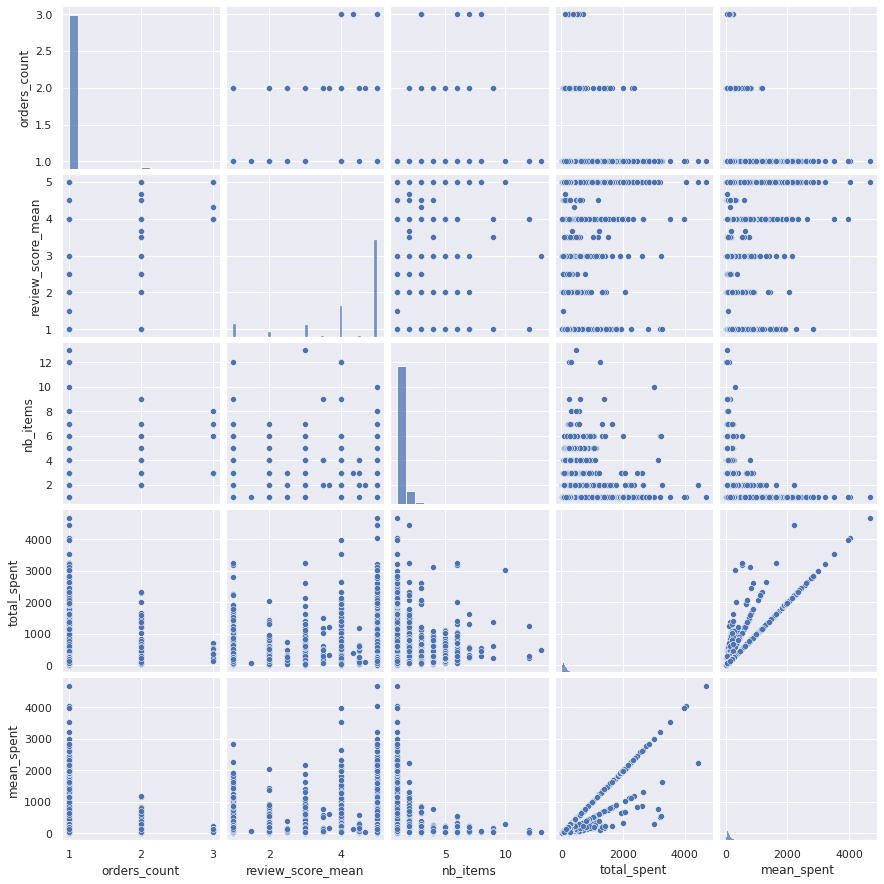

In [8]:
# infos sur les attributs numériques

sns.set(context='notebook', 
        style='darkgrid', 
        palette='deep', 
        font='sans-serif', 
        font_scale=1, 
        color_codes=True, 
        rc=None)

sns.pairplot(data[["orders_count","review_score_mean","nb_items","total_spent","mean_spent"]],
             diag_kind="hist")

plt.savefig("img/bivarie.png", bbox_inches="tight")

On visualise l'asymétrie des dépenses.  
Rien de remarquable dans les relations bivariées.

In [9]:
profile = ProfileReport(data, title='Dernier trimestre (Q2 2018)', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

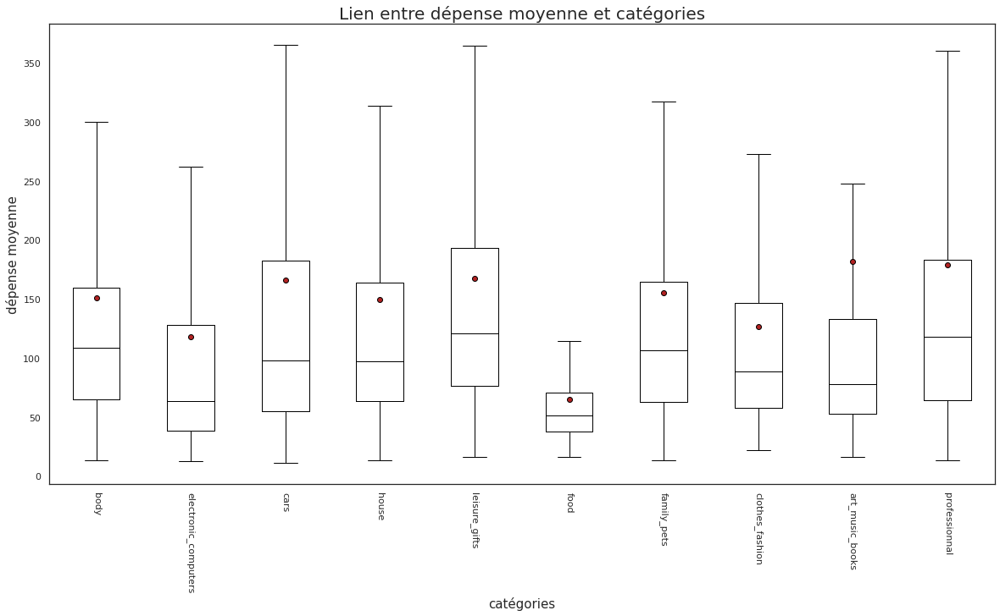

In [19]:
# visualisation de la dépense moyenne par catégorie

sns.set(context='notebook', 
        style='white', 
        palette='deep', 
        font='sans-serif', 
        font_scale=1, 
        color_codes=True, 
        rc=None)

groupes = list()
for cat in grouped_categories.keys():
    groupes.append(data.loc[data[cat]!=0, "mean_spent"])
groupes = np.array(groupes, dtype=object)

medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

fig, ax = plt.subplots(1, 1, figsize=(20,10))

ax.set_title("Lien entre dépense moyenne et catégories", fontsize=20)
ax.set_ylabel("dépense moyenne", fontsize=15)
ax.set_xlabel("catégories", fontsize=15)

ax.boxplot(groupes, showfliers=False, medianprops=medianprops, meanprops=meanprops,
            vert=True, patch_artist=False, showmeans=True)
ax.set_xticklabels(grouped_categories.keys(), rotation=-90)
plt.savefig("img/lien_depense_my_cat.png", bbox_inches="tight")
plt.show()


La moyenne est décalée vers le haut par rapport à la médiane, ce qui indique quelques grosses sommes dépensées.

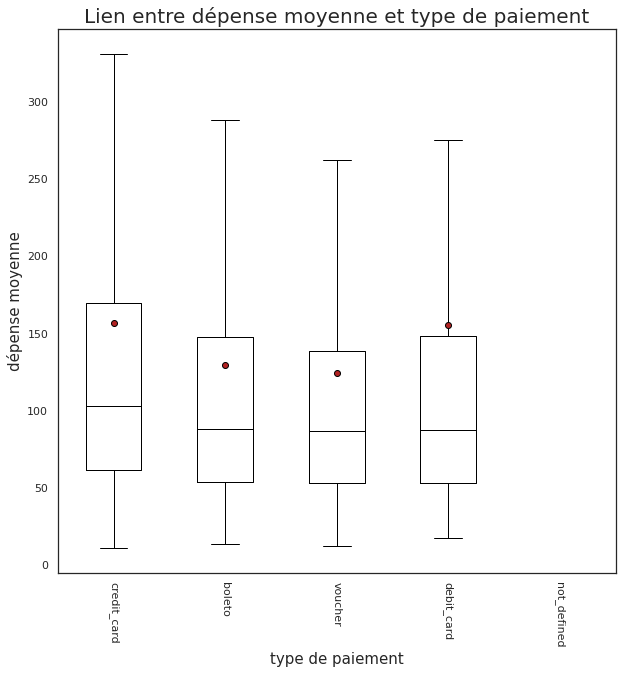

In [21]:
# visualisation de la dépense moyenne par type de paiement

groupes = list()
for pay in list_payment_types:
    groupes.append(data.loc[data[pay]!=0, "mean_spent"])
groupes = np.array(groupes, dtype=object)

medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

fig, ax = plt.subplots(1, 1, figsize=(10,10))

ax.set_title("Lien entre dépense moyenne et type de paiement", fontsize=20)
ax.set_ylabel("dépense moyenne", fontsize=15)
ax.set_xlabel("type de paiement", fontsize=15)

ax.boxplot(groupes, showfliers=False, medianprops=medianprops, meanprops=meanprops, 
            vert=True, patch_artist=False, showmeans=True)
ax.set_xticklabels(list_payment_types, rotation=-90)
plt.savefig("img/lien_depense_my_paiement.png", bbox_inches="tight")
plt.show()


Pourcentage de variance expliquée : 
[0.09902164 0.08740659 0.08133913 0.05693316 0.05588361 0.05351556
 0.0524375  0.05236373 0.05109658 0.05049431]


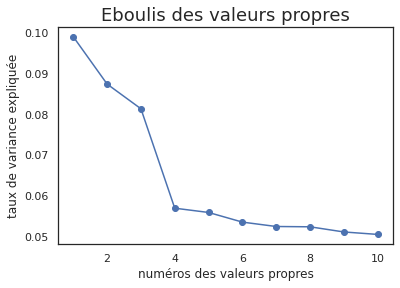

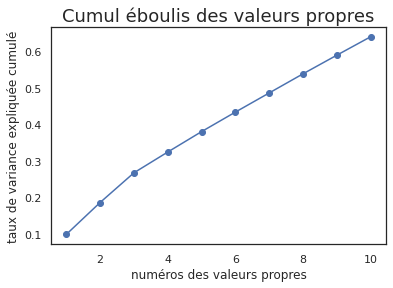

In [22]:
# ACP sur les données normalisées du dernier trimestre

scaler = preprocessing.StandardScaler()
scaled_data = scaler.fit_transform(data)
PCA_quarter = decomposition.PCA(n_components=10)

PCA_quarter.fit(scaled_data)

print("Pourcentage de variance expliquée : ")
print(PCA_quarter.explained_variance_ratio_)

fig = plt.figure()
plt.title("Eboulis des valeurs propres", fontsize=18)
plt.plot(range(1,11),PCA_quarter.explained_variance_ratio_, '-o')
plt.xlabel("numéros des valeurs propres")
plt.ylabel("taux de variance expliquée")
plt.savefig("img/eboulis.png", bbox_inches="tight")
plt.show

fig = plt.figure()
plt.title("Cumul éboulis des valeurs propres", fontsize=18)
plt.plot(range(1,11),PCA_quarter.explained_variance_ratio_.cumsum(), '-o')
plt.xlabel("numéros des valeurs propres")
plt.ylabel("taux de variance expliquée cumulé")
plt.savefig("img/eboulis_cumules.png", bbox_inches="tight")

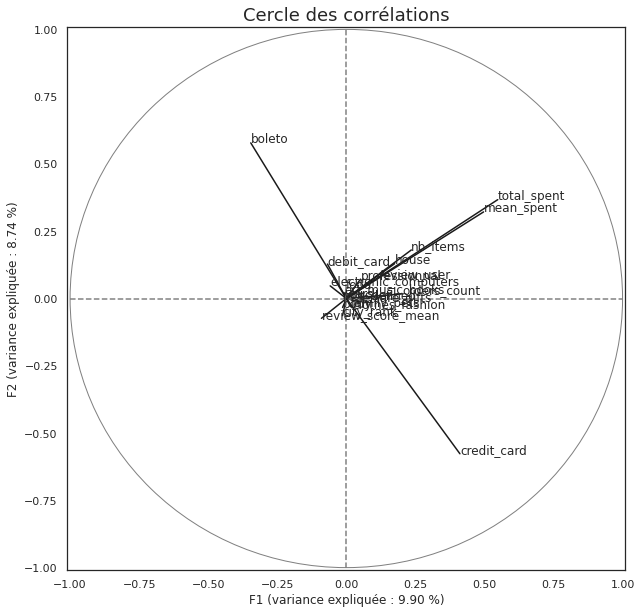

In [23]:
# projection des features sur les deux premiers axes

pcs = PCA_quarter.components_

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
for i, (x, y) in enumerate(zip(pcs[0, :], pcs[1, :])):
    ax.plot([0, x], [0, y], color='k')
    ax.text(x, y, data.columns[i], fontsize='12')

ax.plot([-1,1], [0, 0], color='grey', ls='--')
ax.plot([0, 0], [-1, 1], color='grey', ls='--')
cercle = plt.Circle((0, 0), 1, color='grey', fill=False)
ax.add_artist(cercle)

ax.set_xlabel(f"F1 (variance expliquée : {PCA_quarter.explained_variance_ratio_[0]*100:.2f} %)")
ax.set_ylabel(f"F2 (variance expliquée : {PCA_quarter.explained_variance_ratio_[1]*100:.2f} %)")
ax.set_title("Cercle des corrélations", fontsize=18)

plt.xlim([-1.01, 1.01])
plt.ylim([-1.01, 1.01])

plt.savefig("img/cercle_correlations.png", bbox_inches="tight")

(-1.01, 1.01)

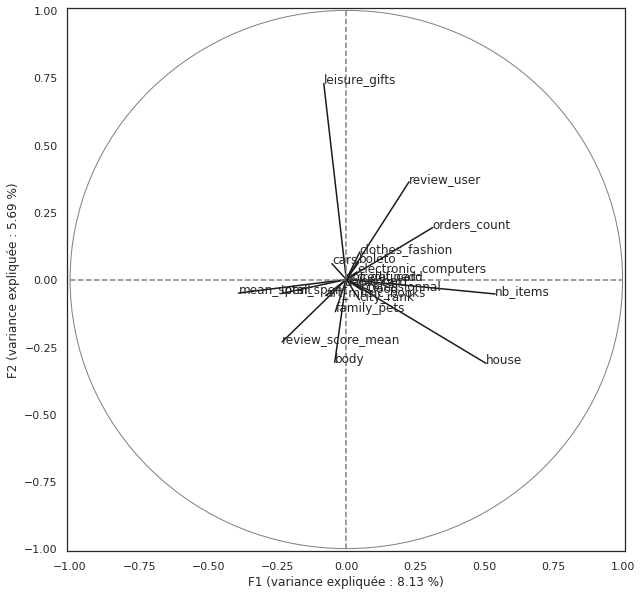

In [24]:
# projection des features sur les 3ème et 4ème axes

pcs = PCA_quarter.components_

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
for i, (x, y) in enumerate(zip(pcs[2, :], pcs[3, :])):
    ax.plot([0, x], [0, y], color='k')
    ax.text(x, y, data.columns[i], fontsize='12')

ax.plot([-1,1], [0, 0], color='grey', ls='--')
ax.plot([0, 0], [-1, 1], color='grey', ls='--')
cercle = plt.Circle((0, 0), 1, color='grey', fill=False)
ax.add_artist(cercle)

ax.set_xlabel(f"F1 (variance expliquée : {PCA_quarter.explained_variance_ratio_[2]*100:.2f} %)")
ax.set_ylabel(f"F2 (variance expliquée : {PCA_quarter.explained_variance_ratio_[3]*100:.2f} %)")


plt.xlim([-1.01, 1.01])
plt.ylim([-1.01, 1.01])

Les pourcentages expliqués sont très faibles sur chaque axe, l'interprétation n'est donc pas très représentative.

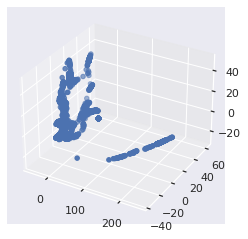

In [15]:
# visualisation par Isomap en 3D des données du dernier mois

data_week = dict_month["2018-08"]
scaled_data_week = preprocessing.StandardScaler().fit_transform(data_week)
isomap = manifold.Isomap(n_components=3, n_jobs=6)

X_transformed = isomap.fit_transform(scaled_data_week)
    
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X_transformed[:,0], X_transformed[:,1], X_transformed[:,2])
plt.show()

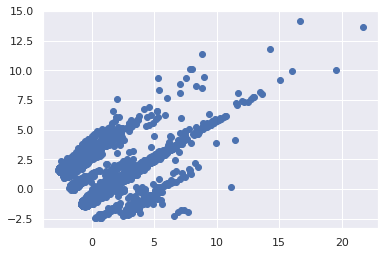

In [16]:
# visualisation en 2D à partir de l'ACP

transformed_data = PCA_quarter.transform(scaled_data)

plt.scatter(transformed_data[:,0], transformed_data[:,1])